# EDA

In [46]:
import IPython.display as ipd
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
from scipy.signal import find_peaks
from skimage.feature.peak import peak_local_max

plt.rcParams["figure.figsize"] = (20, 8)

In [15]:
filename = "songs/10 Heather.wav"

In [16]:
ipd.Audio(filename)

In [123]:
data, sample_rate = librosa.load(filename, sr=22050, mono = True, offset = 0.0, duration=10, res_type="kaiser_best")

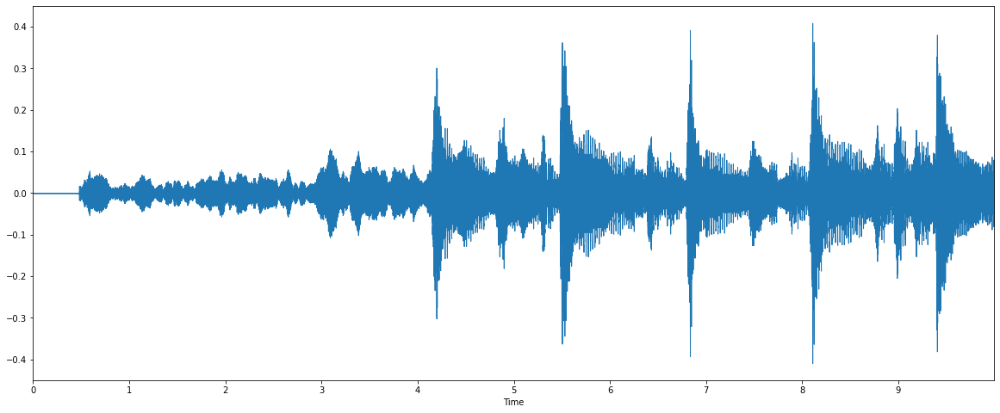

In [149]:
# plot the first 10 secs of a song
librosa.display.waveplot(data, sr=sample_rate, max_points=10000.0, x_axis="time", offset = 0.0, max_sr=1000)

## Signal Processing

With librosa, we can easily plot the spectrogram of a signal

### Spectrogram example

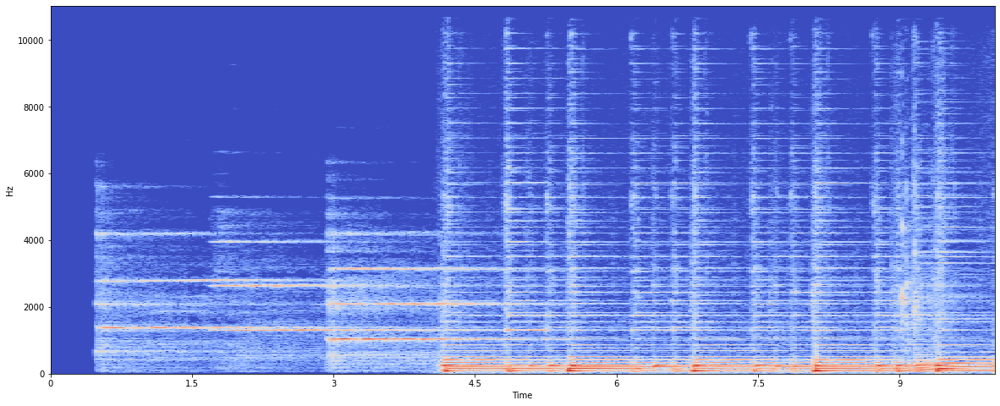

In [147]:
Data = librosa.stft(data) # go from time-domain to frequency-domain
data_db = librosa.amplitude_to_db(abs(Data)) # convert an amplitude spectrogram to dB-scaled spectrogram.
librosa.display.specshow(data_db, sr=sample_rate, x_axis="time", y_axis="hz")
# plt.colorbar()

The vertical axis shows frequencies (from 0 to 10kHz), and the horizontal axis shows the time of the clip. Since we see that all action is taking place at the bottom of the spectrum, we can convert the frequency axis to a logarithmic one.

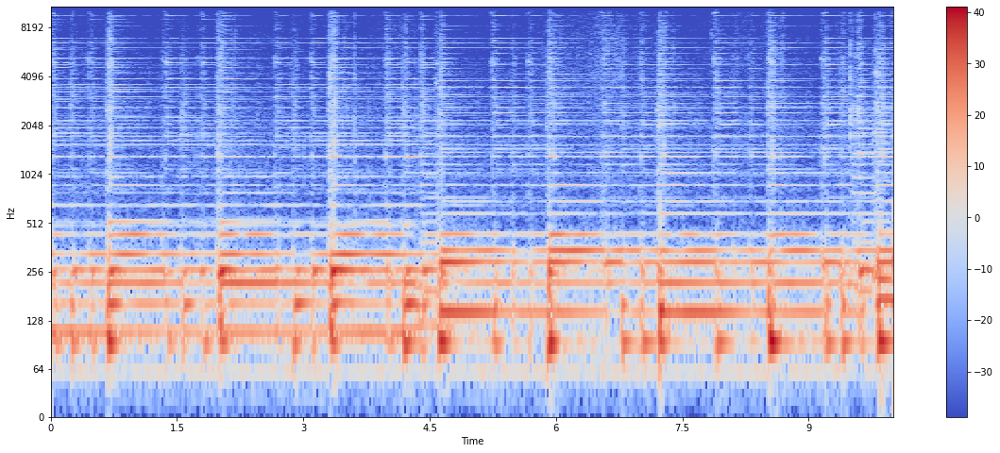

In [87]:
librosa.display.specshow(data_db, sr=sample_rate, x_axis='time', y_axis='log')
plt.colorbar()

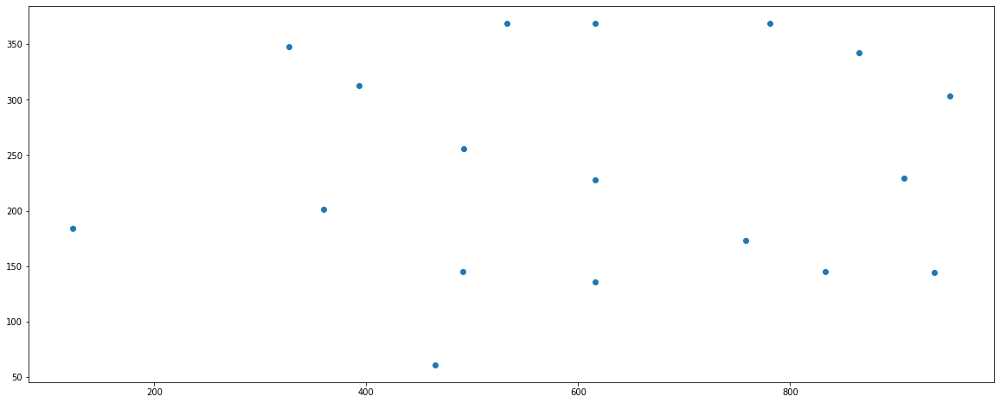

In [90]:
plt.scatter(x, y)

## Signal Processing - 2

Pour analyser notre signal, on a besoin de découper notre séquence en plusieurs parties que l'on va analyser : split with overlap + Hamming Window to smooth the edges

In [ ]:
# split sequence + apply Hamming window
def split_signal(signal, step, size):
    windows = list()
    i = 0
    while True:
        if (i+1)*size >= len(signal) - (1 + size):
            # we stop the slicing when the index is equal to the last value index : have to change that, it is not correct
            break
        else:
            windows.append(signal[i*size, (i+1) * size])

### Get Spectrogram peaks

We want to get the peaks from each spectrogram and plot them to see that they are correct. Since I have to play with the axis and I want to go on with the hashing, we will see this later.

In [151]:
peaks = peak_local_max(data_db, min_distance=60)
peaks
x = [i for i, j in peaks]
y = [j for i, j in peaks]

In [152]:
np.round(data_db[120:130, 180:187], 1)

array([[ -8.3, -18. , -23.2,  -7.5,  -9.4, -17. , -13.9],
       [ -4.4, -13.2, -12.3,  -0.1,   2.1,   0.9,  -0.7],
       [  1.8,  -2.9,   0.2,   0.7,   5.6,   6. ,   2.8],
       [  4.2,   5.4,   2.9,  -9.2,   3.2,   2.7, -15. ],
       [ -1.2,   2.2,  -0.3,  -3.2,  -3.6,  -3.5,  -6.2],
       [-10.5,  -9.6, -16.3, -16.1, -15.3, -10.5, -13.5],
       [ -8.2, -13.9, -23.5, -19.3, -19.7, -17.8, -10.8],
       [-10. , -11.7, -20. , -22. , -26.4, -30.2, -23.7],
       [-21.7, -13.4, -25.3, -36.9, -21.6, -23.3, -21.8],
       [-19.6, -14. , -15.4, -19.1, -28.3, -13. , -12. ]], dtype=float32)

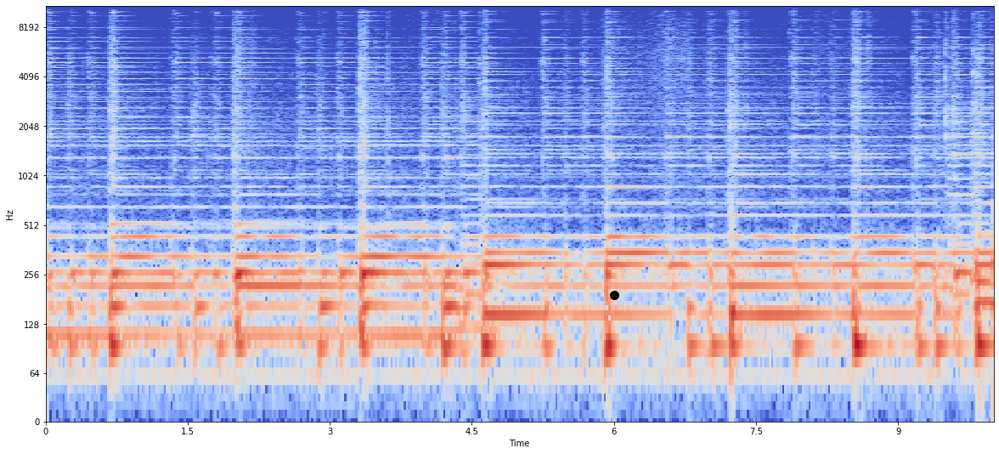

In [105]:
fig = plt.figure(figsize=(20, 9)) #This setups the figure
ax1 = fig.subplots() #Creates the Axes object to display one of the plots

librosa.display.specshow(data_db, x_axis='time', y_axis='log', ax=ax1)
plt.scatter(6, 192, color="black", linewidths=5)
plt.show()